# Session 2: Setting up your environment



## Requirements

1. This GitHub repository (`lancelotblanchard/ai_music_course`)
2. A Python Version Management system (e.g., pyenv or conda)
3. Python 3.12 with a virtual environment `.venv`
4. All of the dependencies in `requirements.txt`
5. Some external libraries

## 1. Cloning the GitHub repository

- Install `git` (version control system)

- Clone https://github.com/lancelotblanchard/ai_music_course.git

- Your file structure should look like this:

<img src="./assets/structure.png" width="50%" />

## 2. Installing PyEnv

- Following the instructions at https://github.com/pyenv/pyenv (e.g., through `curl -fsSL https://pyenv.run | bash`)

- Install Python 3.12 through `pyenv install 3.12`

## 3. Preparing the Python environment

- Create a virtual environment (`python -m venv .venv`)
- Activate it (`. .venv/bin/activate`)
- Install the requirements (`pip install -r requirements.txt`)

## 4. Installing the required programs

- Install FluidSynth (https://github.com/FluidSynth/fluidsynth/wiki/Download)

## Hands-On 1: Manipulating Audio

### 1. Loading, visualizing, playing audio

The audio file we use (Phish Funk - Stargazing) is distributed by Free Music
Archive under a CC BY-NC license.

In [2]:
import librosa

# We can load an audio file using librosa and print its sample rate and the 
# shape of the audio data

y, sr = librosa.load("assets/stargazing.wav")
print("Loaded audio with sample rate:", sr)
print("Audio shape:", y.shape)

Loaded audio with sample rate: 22050
Audio shape: (169344,)


In [3]:
# We can calculate the duration by calculating (number of samples / sample rate)

duration = y.shape[0] / sr
print("Audio duration (seconds):", duration)

Audio duration (seconds): 7.68


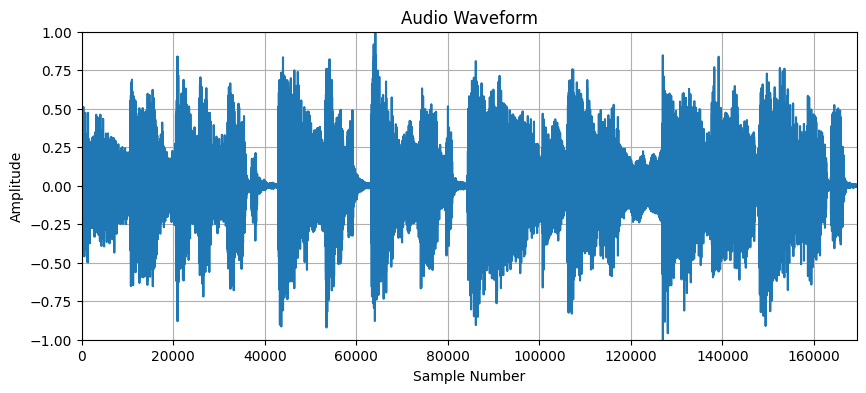

In [4]:
import matplotlib.pyplot as plt

# We can visualize the audio waveform using matplotlib
# The x-axis will be the sample number and the y-axis will be the amplitude

plt.figure(figsize=(10, 4))
plt.plot(y)
plt.title("Audio Waveform")
plt.xlabel("Sample Number")
plt.ylabel("Amplitude")
plt.xlim(0, y.shape[0])
plt.ylim(-1, 1)
plt.grid()
plt.show()

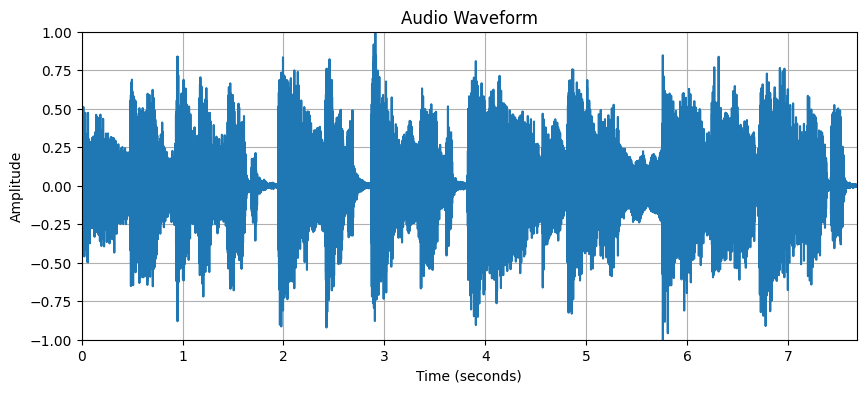

In [5]:
import numpy

# If we want to visualize the audio waveform in a more meaningful way, we can
# convert the sample number to time in seconds.

# The time axis can be created by creating an array from 0 to the duration
# with a step size of 1/sr (= the time between samples)
time = numpy.arange(0, duration, 1/sr)

plt.figure(figsize=(10, 4))
plt.plot(time, y)
plt.title("Audio Waveform")
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.xlim(0, duration)
plt.ylim(-1, 1)
plt.grid()
plt.show()

In [6]:
from IPython.display import Audio, display

# How does our audio sound? We can use IPython's Audio class to create an Audio
# widget that can play the audio in a Jupyter notebook.

display(Audio(y, rate=sr))

### 2. Extracting audio features

`librosa` offers us a toolkit to extract audio features from the audio data.
Most features are calculated over *sliding windows* on our audio data. These
windows are parameterized with a *frame length* and a *hop length*.

In [7]:
frame_length = 2048
hop_length = 512

# With a given hop length, we can calculate the number of frames in the audio data
n_frames = 1 + y.shape[0] // hop_length
print("Number of frames:", n_frames)

Number of frames: 331


#### 2.1. Root Mean Square

There are many features we can extract from audio data. To get a sense of how
the volume of the audio changes over time, we can calculate the Root Mean
Square (RMS) energy of the audio signal. RMS is a measure of the average power
of the signal, and it can be used to estimate the perceived loudness of the
audio.

In [8]:
rms = librosa.feature.rms(y=y, frame_length=frame_length, hop_length=hop_length)
print("RMS shape:", rms.shape) # we should get the same number of frames

RMS shape: (1, 331)


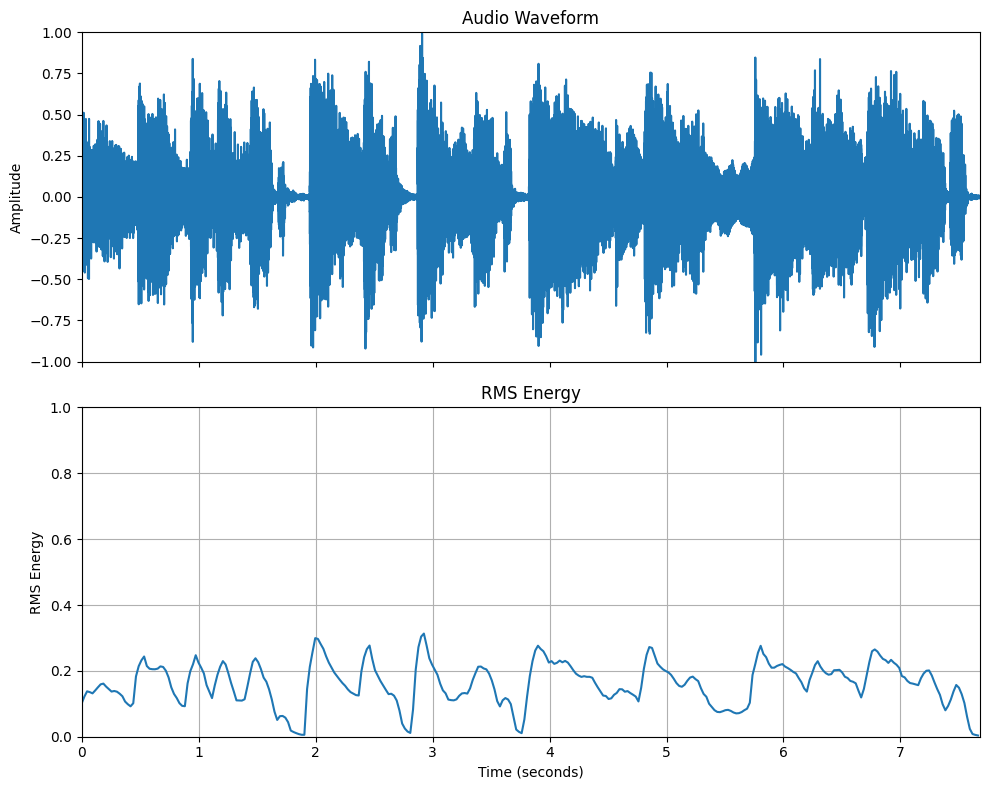

In [9]:
# Let's visualize our RMS signal using matplotlib. We can use the same time axis
# we created before, but we need to make sure to adjust the time axis to match
# the number of frames. The time axis for the RMS signal can be created by 
# creating an array from 0 to the duration with a step size of hop_length/sr
# (= the time between frames). We'll display both the RMS signal and the original
# audio waveform in the same diagram.

fig, ax = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# Original audio
ax[0].plot(time, y)
ax[0].set_title("Audio Waveform")
ax[0].set_ylabel("Amplitude")
ax[0].set_xlim(0, duration)
ax[0].set_ylim(-1, 1)

# RMS signal
rms_time = numpy.arange(0, duration, hop_length/sr)
ax[1].plot(rms_time, rms[0])
ax[1].set_title("RMS Energy")
ax[1].set_xlabel("Time (seconds)")
ax[1].set_ylabel("RMS Energy")
ax[1].set_xlim(0, duration)
ax[1].set_ylim(0, 1)
ax[1].grid()

plt.tight_layout()
plt.show()

We can see that the beats concide with high RMS values.

#### 2.2. Zero-crossing Rate

Another feature we can extract is the Zero Crossing Rate (ZCR). The ZCR is the
rate at which the signal changes from positive to negative or vice versa. It
represents the frequency of the signal and is generally used to detect
percussions, vocal activity, and other transient sounds. The ZCR is calculated
by counting the number of times the signal crosses zero in a given frame.

In [10]:
zcr = librosa.feature.zero_crossing_rate(y=y, frame_length=frame_length, hop_length=hop_length)
print("ZCR shape:", zcr.shape) # we should get the same number of frames

ZCR shape: (1, 331)


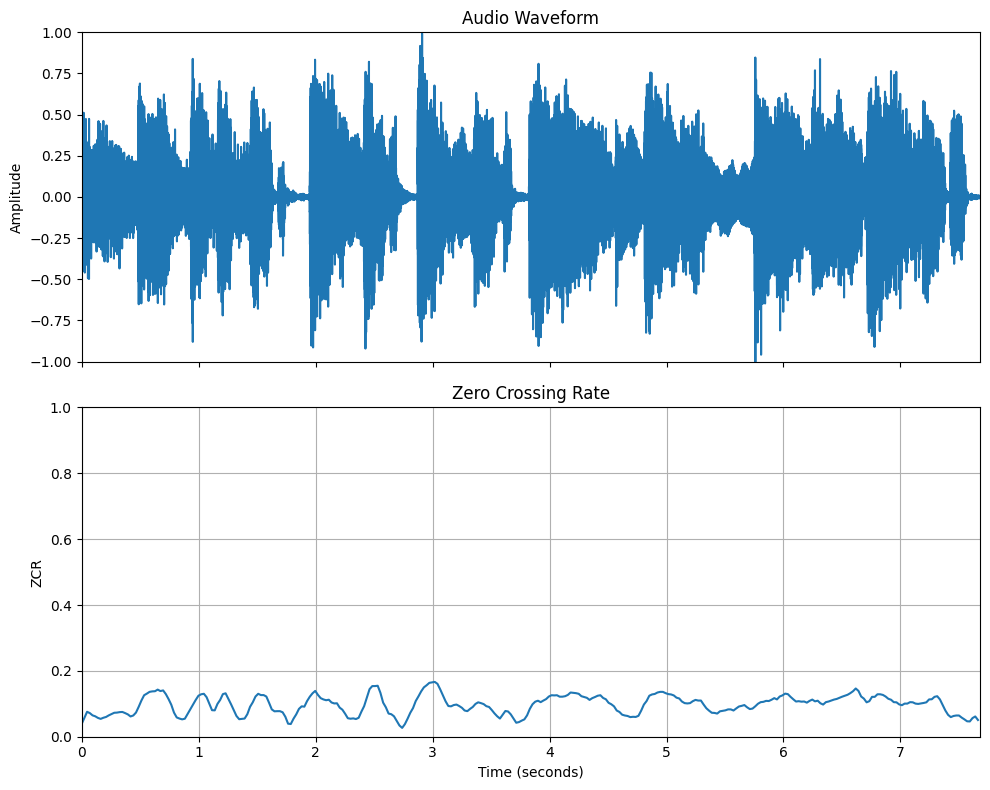

In [11]:
# We use the same method as before to visualize the ZCR signal.

fig, ax = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# Original audio
ax[0].plot(time, y)
ax[0].set_title("Audio Waveform")
ax[0].set_ylabel("Amplitude")
ax[0].set_xlim(0, duration)
ax[0].set_ylim(-1, 1)

# ZCR signal
zcr_time = numpy.arange(0, duration, hop_length/sr)
ax[1].plot(zcr_time, zcr[0])
ax[1].set_title("Zero Crossing Rate")
ax[1].set_xlabel("Time (seconds)")
ax[1].set_ylabel("ZCR")
ax[1].set_xlim(0, duration)
ax[1].set_ylim(0, 1)
ax[1].grid()

plt.tight_layout()
plt.show()

#### 2.3. Spectrogram via Short-Time Fourier Transform

A core concept in audio processing is the Short-Time Fourier Transform (STFT).
The STFT is a way to represent a signal in the time-frequency domain (see
picture). It allows us to separate a signal into all of its frequency
components and see how they change over time. The STFT is calculated by
taking a window of the signal, applying a Fourier Transform to it, and
sliding the window over the signal. The result is a 2D array where the
rows represent the frequency bins and the columns represent the time frames.
The STFT is a complex-valued array (where the complex component represents the
phase of the signal), so we can use the magnitude of the STFT to only keep
the amplitude information.

<img src="https://miro.medium.com/v2/resize:fit:1400/format:webp/1*xTYCtcx_7otHVu-uToI9dA.png" width="50%">

In [12]:
n_fft = 2048 # number of samples in the FFT window

# We can calculate the STFT using librosa's stft function. The STFT is a
# complex-valued matrix of shape (n_fft/2+1, n_frames) that contains the
# complex-valued STFT coefficients for each frame.
stft = librosa.stft(y, n_fft=n_fft, hop_length=hop_length)
print("STFT shape:", stft.shape) # we should get (n_fft/2+1, n_frames)

STFT shape: (1025, 331)


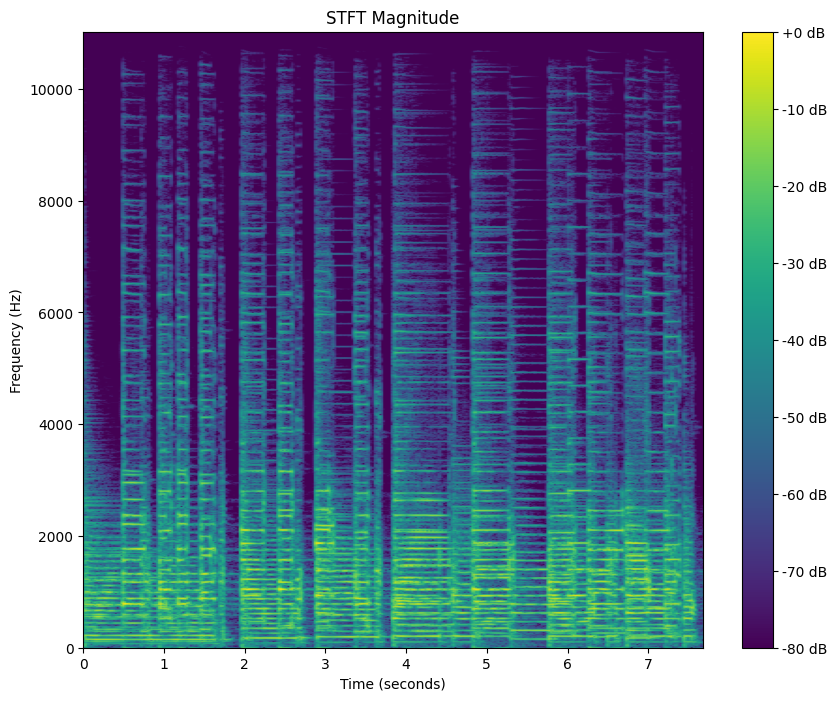

In [14]:
# Let's visualize the STFT using matplotlib. We will use the imshow function to
# create a heatmap of the STFT coefficients. The x-axis will be the frame number
# and the y-axis will be the frequency bin number. The color of each pixel will
# represent the magnitude of the STFT coefficient at that frequency and time.

# We will use librosa's amplitude_to_db function to convert the STFT
# coefficients to decibels. The decibel scale is a logarithmic scale that is
# closely related to the human perception of sound.

plt.figure(figsize=(10, 8))
plt.imshow(librosa.amplitude_to_db(numpy.abs(stft), ref=numpy.max),
           origin='lower', aspect='auto', 
           extent=[0, duration, 0, sr/2])
plt.title("STFT Magnitude")
plt.xlabel("Time (seconds)")
plt.ylabel("Frequency (Hz)")
plt.colorbar(format='%+2.0f dB')
plt.xlim(0, duration)
plt.ylim(0, sr/2)
plt.show()

#### 2.2. Mel-Frequency Cepstral Coefficients (MFCCs)

Another feature we can extract from audio data is the Mel-frequency cepstral
coefficients (MFCCs). MFCCs are a representation of the short-term power
spectrum of sound, and they are commonly used in speech and audio processing
tasks. They are based on the human ear's perception of sound, and they can
be used to represent the timbre of an audio signal.

In [15]:
n_mfcc = 13 # number of MFCCs to compute

mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=frame_length, hop_length=hop_length)
print("MFCC shape:", mfcc.shape) # we should get the same number of frames, with n_mfcc rows

MFCC shape: (13, 331)


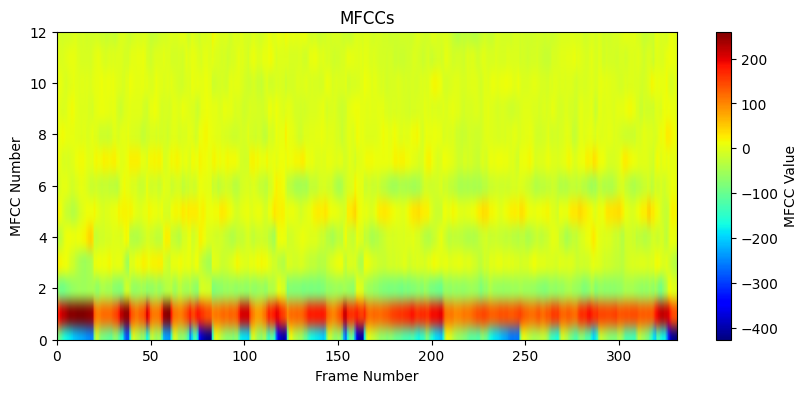

In [19]:
# MFCCs are usually visualized with heatmaps, where the x-axis is the frame
# number and the y-axis is the MFCC number. The color intensity represents the
# value of the MFCC.

plt.figure(figsize=(10, 4))
plt.imshow(mfcc, aspect='auto', origin='lower', cmap='jet')
plt.title("MFCCs")
plt.xlabel("Frame Number")
plt.ylabel("MFCC Number")
plt.colorbar(label="MFCC Value")
plt.xlim(0, mfcc.shape[1])
plt.ylim(0, n_mfcc - 1)
plt.show()

## Hands-On 2: Manipulating MIDI Data

As discussed, we can also work with a more symbolic representation of our
music data through the widespread MIDI format.

<img src="./assets/midi_data.png" width="70%" />

### 1. Loading and playing MIDI data

In [20]:
import mido

# We will load a MIDI file using mido and examine the number of tracks and the
# number of messages in each track.

midi_file = mido.MidiFile("assets/symphony40.mid")
print("Number of tracks:", len(midi_file.tracks))
for i, track in enumerate(midi_file.tracks):
    print(f"Track {i}, instrument: {track.name}, number of messages: {len(track)}")

# Remember, MIDI messages include both notes on and notes off.

Number of tracks: 4
Track 0, instrument: Violin (Classic), number of messages: 16897
Track 1, instrument: Flute, number of messages: 3333
Track 2, instrument: French Horn (Classic), number of messages: 2613
Track 3, instrument: Cello (Classic), number of messages: 2561


In [44]:
import numpy as np
from math import ceil

# Visualizing MIDI data is not as straightforward as audio data, but we can do
# so through a piano roll. A piano roll is a 2D representation of MIDI data,
# where the x-axis is time and the y-axis is pitch. To create this
# representation, we first need to define convert our event-based MIDI data
# into a time-based representation.

# Although there are some (limited) libraries that can convert MIDI to piano
# rolls, we will use numpy to process our MIDI data and create an array that
# represents a piano roll that we can visualize. Our piano roll will be of shape
# (instruments, 128, max_ticks), where instruments is the number of instruments
# in the MIDI file, 128 is the number of MIDI notes (0-127), and max_ticks is
# the maximum number of ticks in the MIDI file.


def midi_to_piano_roll(midi_file, ticks_per_beat=480):
    # Create an empty piano roll
    max_ticks = sum([x.time for x in mido.merge_tracks(midi_file.tracks)])
    instruments = len(midi_file.tracks)
    piano_roll = np.zeros((instruments, 128, max_ticks), dtype=np.uint8)

    # Iterate through each track and each message
    for i, track in enumerate(midi_file.tracks):
        notes_on = {}
        time = 0
        for msg in track:
            if msg.type == 'note_on':
                # Convert the time to ticks
                time += msg.time
                # Add the note to the notes_on dictionary (ignore if already on)
                if msg.note not in notes_on:
                    notes_on[msg.note] = time
            elif msg.type == 'note_off':
                # Convert the time to ticks
                time += msg.time
                # If the note is on, turn it off and add it to the piano roll
                if msg.note in notes_on:
                    start_time = notes_on[msg.note]
                    # Add the note to the piano roll
                    piano_roll[i, msg.note, start_time:time] = 1
                    # Remove the note from the notes_on dictionary
                    del notes_on[msg.note]

    # Return the piano roll
    return piano_roll
piano_roll = midi_to_piano_roll(midi_file)
print("Piano roll shape:", piano_roll.shape) # should be (instruments, 128, max_ticks)

Piano roll shape: (4, 128, 615744)


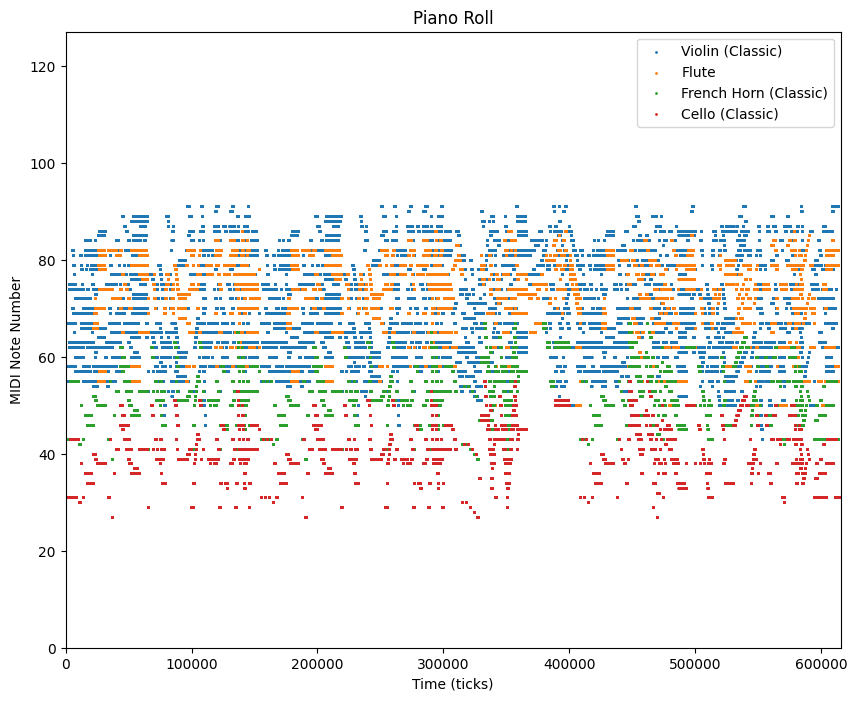

In [48]:
# Let's visualize the piano roll using matplotlib. We will use the scatter
# function for each instrument to plot the notes on the piano roll. The x-axis
# will be the time in ticks and the y-axis will be the MIDI note number. The
# color of each point will represent the instrument number.

plt.figure(figsize=(10, 8))
for i in range(piano_roll.shape[0]):
    # Get the notes for the current instrument
    notes = np.where(piano_roll[i] > 0)[0]
    times = np.where(piano_roll[i] > 0)[1]
    plt.scatter(times, notes, s=1, label=midi_file.tracks[i].name)

plt.title("Piano Roll")
plt.xlabel("Time (ticks)")
plt.ylabel("MIDI Note Number")
plt.xlim(0, piano_roll.shape[2])
plt.ylim(0, 127)
plt.legend()
plt.show()

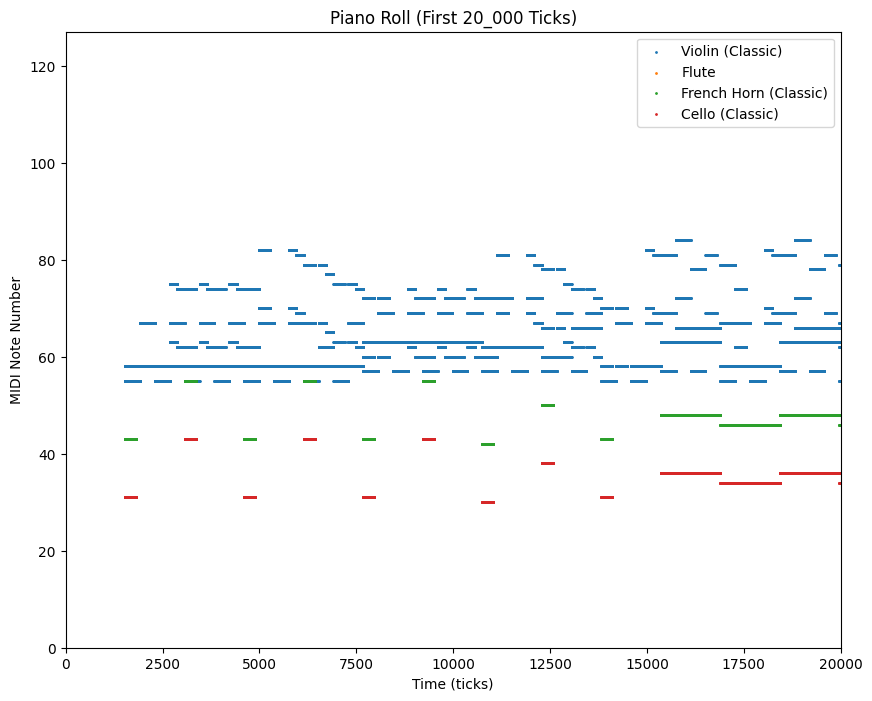

In [51]:
# Let's visualize the first 20 000 ticks of the piano roll to get a better view.

plt.figure(figsize=(10, 8))
for i in range(piano_roll.shape[0]):
    # Get the notes for the current instrument
    notes = np.where(piano_roll[i][:20_000] > 0)[0]
    times = np.where(piano_roll[i][:20_000] > 0)[1]
    plt.scatter(times, notes, s=1, label=midi_file.tracks[i].name)

plt.title("Piano Roll (First 20_000 Ticks)")
plt.xlabel("Time (ticks)")
plt.ylabel("MIDI Note Number")
plt.xlim(0, 20_000)
plt.ylim(0, 127)
plt.legend()
plt.show()

In [60]:
import midi2audio

# Now, we can listen to the MIDI file using IPython's Audio class. We will use
# the midi2audio library to synthesize the MIDI file into audio. We will use the
# soundfont file "assets/soundfont.sf2" to synthesize the MIDI file. You can
# download a soundfont file from the internet or use one of your own.

soundfont_file = "assets/soundfont.sf2"
midi2audio_obj = midi2audio.FluidSynth(soundfont_file)
midi2audio_obj.midi_to_audio("assets/symphony40.mid", "assets/symphony40.wav")

# Now we can load the synthesized audio file and listen to it.
y, sr = librosa.load("assets/symphony40.wav")
print("Loaded MIDI audio with sample rate:", sr)
print("Audio shape:", y.shape)
print("Audio duration (seconds):", y.shape[0] / sr)

display(Audio(y, rate=sr))


fluidsynth: panic: An error occurred while reading from stdin.
fluidsynth: panic: An error occurred while reading from stdin.


FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'assets/symphony40.wav'..
Loaded MIDI audio with sample rate: 22050
Audio shape: (11226144,)
Audio duration (seconds): 509.1221768707483
